---
title: "Lab-6"
author: "Brian Kwon"
---

In [10]:
library(tidyverse)
library(mvtnorm)
library(plotly)
library(MASS)
library(ggplot2)
# threejs Javascript plot
library(threejs)

Loading required package: igraph


Attaching package: 'igraph'


The following object is masked from 'package:plotly':

    groups


The following objects are masked from 'package:lubridate':

    %--%, union


The following objects are masked from 'package:dplyr':

    as_data_frame, groups, union


The following objects are masked from 'package:purrr':

    compose, simplify


The following object is masked from 'package:tidyr':

    crossing


The following object is masked from 'package:tibble':

    as_data_frame


The following objects are masked from 'package:stats':

    decompose, spectrum


The following object is masked from 'package:base':

    union




# Multi-varite Normal

## 1. Simulation of bivariate normal distribution

Start with two independent $Z_1, Z_2 \sim N(0,1)$.

- $\quad$ Set $X=\mu_x+\sigma_x Z_1$.
- $\quad$ Set $Y=\mu_y+\sigma_y\left(\rho Z_1+\sqrt{1-\rho^2} Z_2\right)$.
- Theoretical results imply: $X$ and $Y$ have normal distributions.

a. First let's Check the correctness of  the formula we did in class.

[1] 2.003919

[1] 1.517474

[1] 0.506241

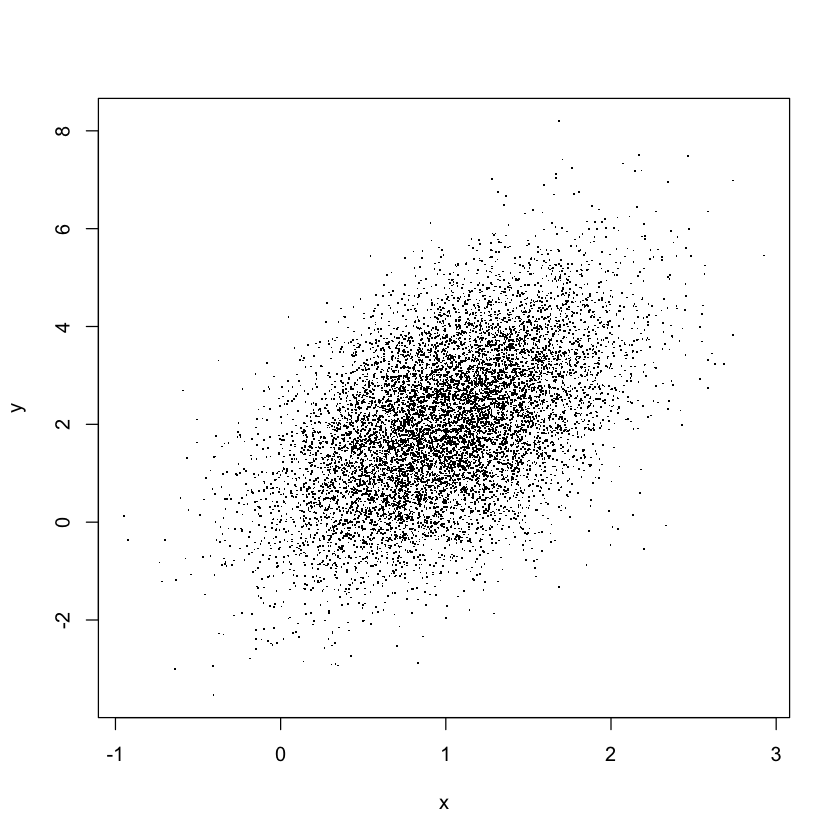

In [11]:
N= 10000
mymux = 1
mysigx = .5
mymuy = 2
mysigy = 1.5
myrho = .5  #positive moderate correlation

Z1 = rnorm(N)
Z2 = rnorm(N)

x <- mymux + mysigx*Z1


y <- mymuy + mysigy*(myrho*Z1 + sqrt(1-myrho^2)*Z2)

mean(y) # should be ~ 2
sd(y) # should be ~ 1.5 
cor(x,y) # should be ~ .5

plot(x,y,pch = 46)#positive moderate correlation

_We see that mean and standard deviation of  y  and the correlation coefficient are all close to the theoretical values._

b. Write a function that does the simulation using the formula that we found in class (checked above)

In [12]:
# Simulate bivariate normal distribution

mybivar = function(size = 1, mu1=0, mu2 = 0, sig1 = 1, sig2 = 1, rho = 0){
  mydf = data.frame(x = rep(NA,size), y = rep(NA,size))
  z1 = rnorm(size)
  z2 = rnorm(size)
  x = sig1*z1 + mu1
  y = sig2*(rho*z1 + sqrt(1-rho^2)*z2) + mu2
  return(data.frame(x = x, y = y))
}

c. Try it out and plot the result.


,x,y
,<dbl>,<dbl>
1,1.8204165,0.5066532
2,1.3382935,1.3266352
3,0.7149483,2.2119530
4,0.7602209,3.5993462
5,1.0103180,1.9485145
6,1.5194315,1.3085918


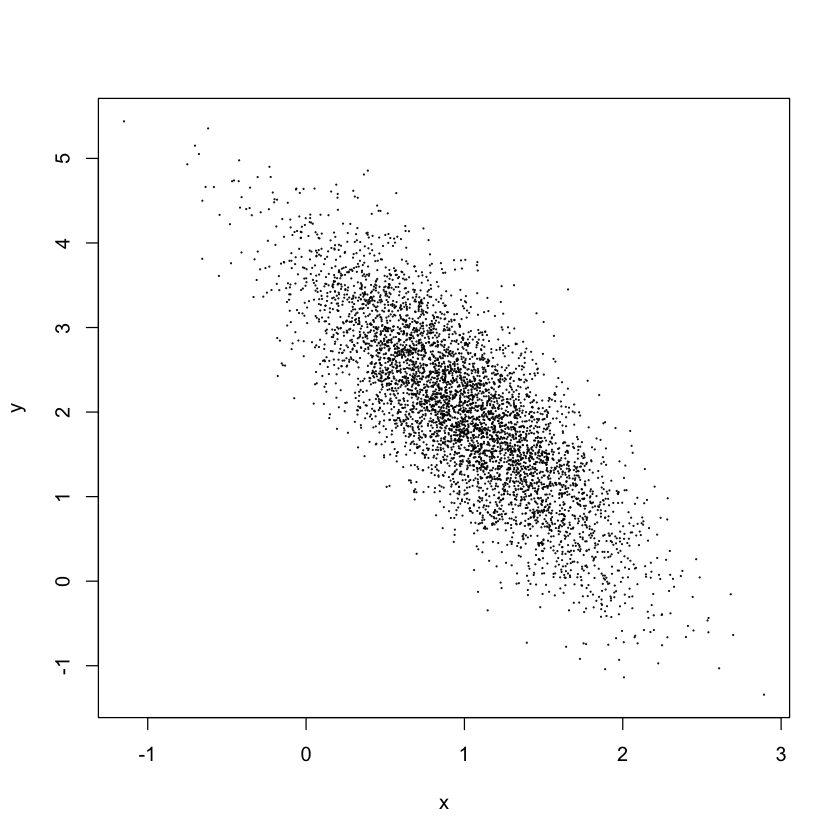

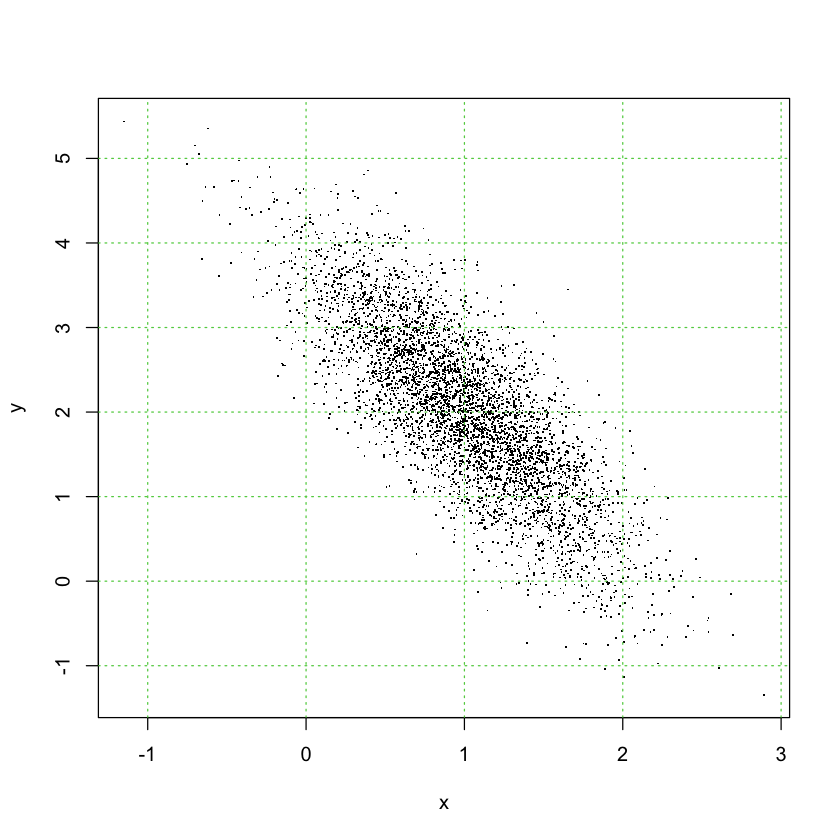

In [13]:
N = 5000
mymux = 1
mymuy = 2
mysigx = .5
mysigy = 1
myrho = -.8 #-negative high correlation

mydf = mybivar(N, mymux, mymuy, mysigx, mysigy, myrho)
head(mydf)
plot(mydf, cex = .1) #-negative high correlation

#or 

plot(mydf, pch = 46)
grid(col = 3) 

_Try different values of  myrho  to see how the shape of the scatter plot changes with the correlation coefficient._

d. Let's try the 3d plot

In [14]:
dens <- kde2d(mydf$y,mydf$x)

plot_ly(x = dens$x,
        y = dens$y,
        z = dens$z) %>% add_surface() #z- An n[1] by n[2] matrix of the estimated density: rows correspond to the value of x, columns to the value of y.

HTML widgets cannot be represented in plain text (need html)

e. 3D scatter plot

In [15]:
# Unpack data from kde grid format
x <- dens$x; y <- dens$y; z <- dens$z
# Construct x,y,z coordinates
xx <- rep(x,times=length(y))
yy <- rep(y,each=length(x))
zz <- z; dim(zz) <- NULL
# Set up color range
ra <- ceiling(16 * zz/max(zz))
col <- rainbow(16, 2/3)
# 3D interactive scatter plot
scatterplot3js(x=xx,y=yy,z=zz,size=0.4,color = col[ra],bg="black")

Warning message in ans[i] <- sprintf("%.2e", x):
"number of items to replace is not a multiple of replacement length"


HTML widgets cannot be represented in plain text (need html)

## 2. Multivariate normal

Check more on the "mvtnorm" package: <https://www.rdocumentation.org/packages/mvtnorm/versions/1.1-3>

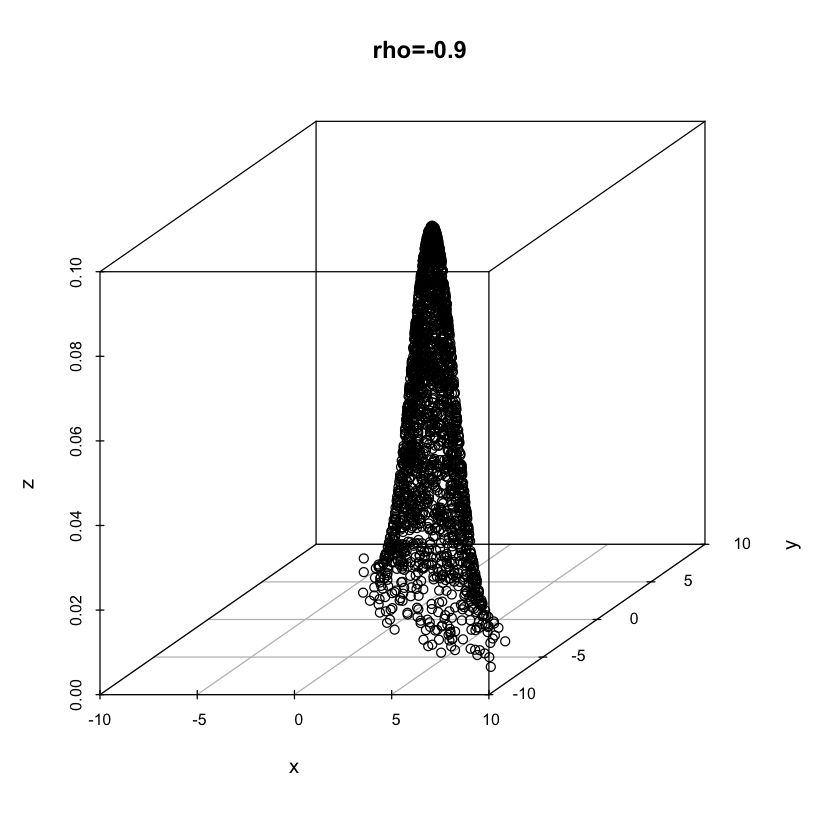

In [7]:
#install.packages("scatterplot3d") # Install
library("scatterplot3d") # load

library(mvtnorm) #multivariate normal #3d plot set.seed(1)
N <- 2000 # Number of random samples set.seed(123)
# Target parameters for univariate normal distributions 
rho <- -0.9
mu1 <- 1; s1 <- 2 #sigmax
mu2 <- 1; s2 <- 2 #sigmay

# Parameters for bivariate normal distribution
mu <- c(mu1,mu2) # Mean
sigma <- matrix(c(s1^2, s1*s2*rho, s1*s2*rho, s2^2),2) # Covariance matrix

#or
#sigma = diag(2)

XY = rmvnorm(N, mu, sigma) 
fxy = dmvnorm(XY, mu, sigma)
x = as.matrix(XY[,1])
y = as.matrix(XY[,2])
z = as.matrix(fxy)

scatterplot3d(x, y, z, main='rho=-0.9')

## 3. Conditional expectations from bivariate normal distribution

- Given $y, X \mid Y=y$ has a normal distribution.
- Mean: $E(X \mid Y=y)=\mu_x+\rho \frac{\sigma_x}{\sigma_y}\left(y-\mu_y\right)$
- We can write $E(X \mid Y)=a Y+b$  (an example of a regression equation)
- If $\rho>0$, adjust the expected value in the direction of the new information $y-\mu_y$
- Variance: $\operatorname{var}(X \mid Y=y)=\left(1-\rho^2\right) \sigma_x^2$
- $\operatorname{var}(X \mid Y)$ does not depend on $Y$ or $\mu_y$ or $\sigma_y$, only on $\rho$ and $\sigma_X$. It just becomes smaller.
- The fact that $\operatorname{var}(X \mid Y)=\left(1-\rho^2\right) \operatorname{var}(X)$ for all values of $Y$ shows that we can predict $X$ more accurately if $Y$ is known.


Make an approximate sample from $X|Y = 1$.

Since Y is a continuous variable, we won't be able to find values where Y is exactly equal to 1. Therefore, we will throw away all cases where $Y$ is _not close to 1_.That is we keep only the samples where $.95 < Y < 1.05$.

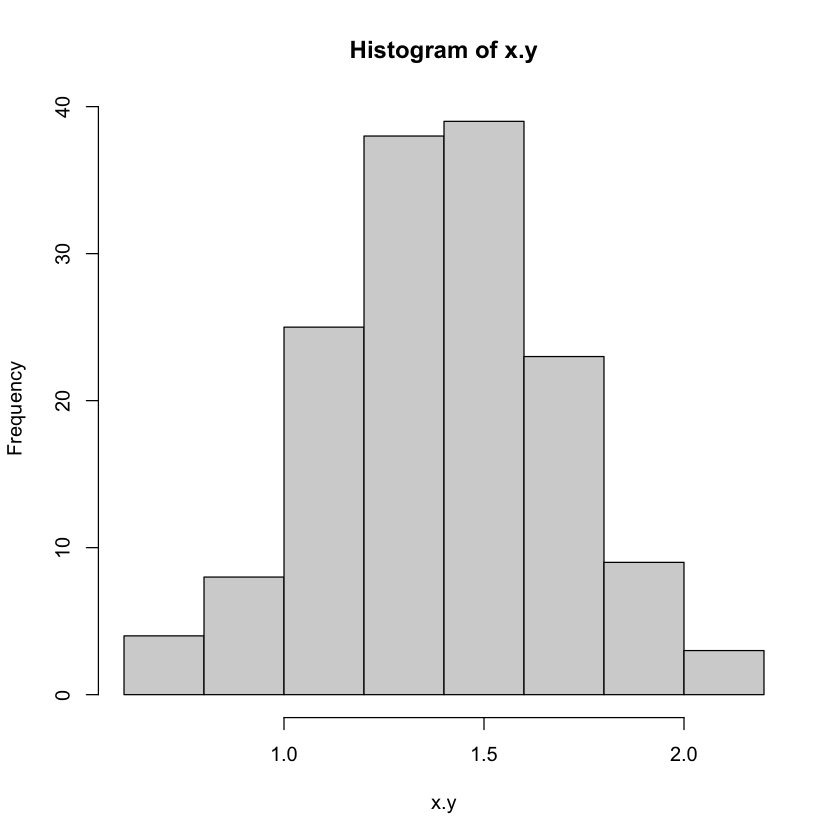

In [8]:
y0 = 1
keep = mydf$y < y0 + .05 & mydf$y > y0 - .05 #because continous r.v
x.y = mydf$x[keep] #conditional X|Y=1
hist(x.y)

In [9]:
fig <- plot_ly(x = ~x.y, type = "histogram") %>%
  layout(title = 'Distribution of the Conditional Variable X|Y=1')
fig

HTML widgets cannot be represented in plain text (need html)

[1] 1.38601

[1] 0.08342806

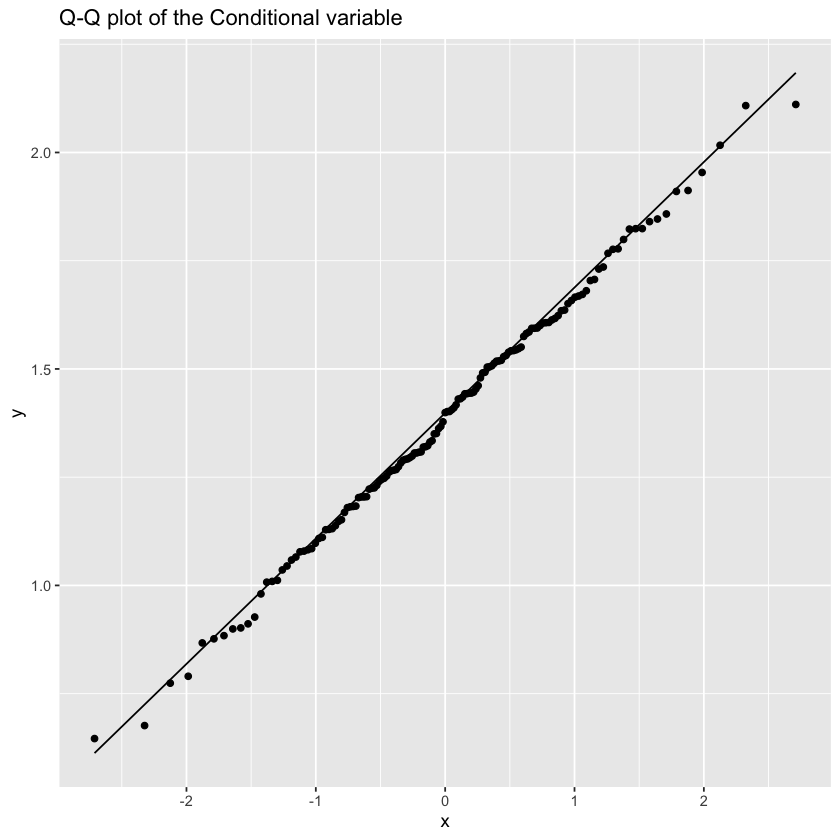

In [10]:
df <- data.frame(y = x.y)
p <- ggplot(df, aes(sample = y))
p + stat_qq() + stat_qq_line()+
  ggtitle ("Q-Q plot of the Conditional variable")

#qqnorm(x.y)
mean(x.y)
var(x.y)

It is clear that the conditional distribution is also follows a normal distribution.

b. Theoretical mean and variance:


In [11]:
#given in the picture above
mymux + myrho*mysigx/mysigy*(y0 - mymuy)
(1-myrho^2)*mysigx^2

[1] 1.4

[1] 0.09

c. Scatterplot and theoretical regression line

We must plot  x  against  y.

The red line shows  the function $E(X|Y=y)$ 

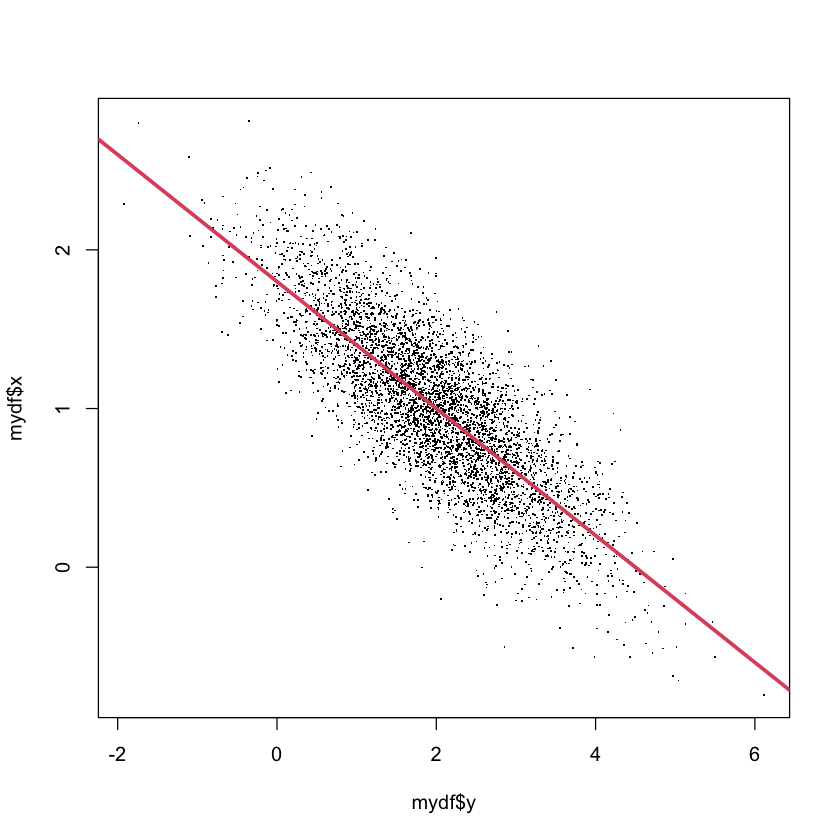

In [12]:
plot(mydf$y,mydf$x, pch = 46) #joint distribution of x and y
abline(a = mymux - myrho*mysigx/mysigy*mymuy, b = myrho*mysigx/mysigy, col = 2, lwd = 3) 

# Multinomial distribution

Recall: The multinomial distribution is a generalization of the binomial distribution to k categories instead of just binary (success/fail). For n independent trials each of which leads to a success for exactly one of k categories, the multinomial distribution gives the probability of any particular combination of numbers of successes for the various categories.

_Example: Rolling a die N times_

## Multinomial Examples

### 1. Chess Game Prediction

Two chess players have the probability Player A would win is 0.40, Player B would win is 0.35, game would end in a draw is 0.25.

The multinomial distribution can be used to answer questions such as: “If these two chess players played 12 games, what is the probability that Player A would win 7 games, Player B would win 2 games, the remaining 3 games would be drawn?”


In [13]:
#12 trails, 3 variables (A win,  B win, draw)
dmultinom(x=c(7,2,3), prob = c(0.4,0.35,0.25))

[1] 0.02483712

### 2. Opinion Polls on Election

In a little town, 40% of the eligible voters prefer candidate A, 10% prefer candidate B, 50% have no preference.

You randomly sample 10 eligible voters. What is the probability that 4 will prefer candidate A, 1 will prefer candidate B, 5 will have no preference ? 


In [14]:
dmultinom(x=c(4,1,5), prob = c(0.4,0.1,0.5))

[1] 0.1008

## 2. Generate Multinomial Random Variables

Generate Multinomial Random Variables With varying Probabilities, given a matrix of multinomial probabilities where rows correspond to observations and columns to categories (and each row sums to 1). Generate a matrix with the same number of rows as `my_prob` and with m columns. The columns represent multinomial cell numbers, and within a row, the columns are all samples from the same multinomial distribution.

In [15]:
# rmultinom(n, size, prob)
my_prob <- c(0.2,0.3,0.1,0.4)
number_of_experiments <- 20 #trials

### (a). Number of Samples = 10

In [16]:
number_of_samples <- 10 

experiments <- rmultinom(n=number_of_experiments, size=number_of_samples, prob=my_prob)
experiments


df=data.frame(experiments) 
df
colSums(df)

dff= t(df)
colnames(dff) <- c("x1","x2","x3","x4")
rownames(dff) <- NULL
dff
rowSums(dff)

1,4,1,0,2,4,1,1,3,1,3,1,4,0,4,2,1,3,0,1
3,3,3,3,3,1,2,4,4,2,3,3,1,2,3,4,4,3,5,4
1,2,1,2,1,2,1,1,0,1,1,0,4,2,1,1,0,2,1,1
5,1,5,5,4,3,6,4,3,6,3,6,1,6,2,3,5,2,4,4


X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,X11,X12,X13,X14,X15,X16,X17,X18,X19,X20
<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,4,1,0,2,4,1,1,3,1,3,1,4,0,4,2,1,3,0,1
3,3,3,3,3,1,2,4,4,2,3,3,1,2,3,4,4,3,5,4
1,2,1,2,1,2,1,1,0,1,1,0,4,2,1,1,0,2,1,1
5,1,5,5,4,3,6,4,3,6,3,6,1,6,2,3,5,2,4,4


X1  X2  X3  X4  X5  X6  X7  X8  X9 X10 X11 X12 X13 X14 X15 X16 X17 X18 X19 X20 
 10  10  10  10  10  10  10  10  10  10  10  10  10  10  10  10  10  10  10  10

x1,x2,x3,x4
1,3,1,5
4,3,2,1
1,3,1,5
0,3,2,5
2,3,1,4
4,1,2,3
1,2,1,6
1,4,1,4
3,4,0,3
1,2,1,6


[1] 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10

### (b). plotting the marginals

There are 10000 different ways of arranging these 4 variables with 10 trials. That is what n is in the `rmultinom()` function. Then I'm looking at the marginals of x1, x2, x3, x4 where x1, x2, x3, x4 can take values from 0 to 10. You can see that the probabilities in each marginal distribution add up to 1.


HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

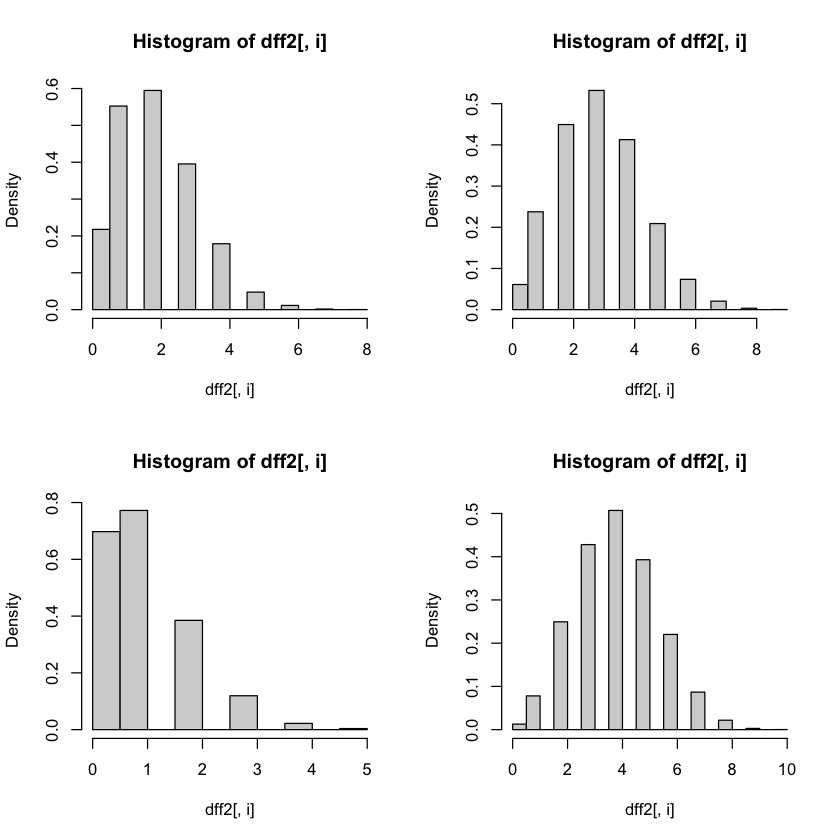

In [17]:
#(dfM=data.frame(experiments)/number_of_samples ) #gives me probabilities
#dffM= t(dfM)
#colnames(dffM) <- c("x1","x2","x3","x4")
#rownames(dffM) <- NULL
#dffM
#rowSums(dffM)

e2 <- rmultinom(n=10000, size=10, prob=my_prob)


dff2= t(data.frame(e2))
colnames(dff2) <- c("x1","x2","x3","x4")

par(mfrow=c(2,2))

for(i in 1:4) {
  hist(dff2[,i],prob=T) 
}


dff2<-data.frame(dff2)

#################### using plotly ############################


fig1 <- plot_ly(x = ~as.factor(dff2[,1]), type = "histogram",histnorm = "probability") %>%
  layout(title = 'Marginal of X1')
fig1


####### 

fig2 <- plot_ly(x = ~as.factor(dff2[,2]), type = "histogram",histnorm = "probability") %>%
  layout(title = 'Marginal of X2')
fig2

fig3 <- plot_ly(x = ~as.factor(dff2[,3]), type = "histogram",histnorm = "probability") %>%
  layout(title = 'Marginal of X3')
fig3

fig4 <- plot_ly(x = ~as.factor(dff2[,4]), type = "histogram",histnorm = "probability") %>%
  layout(title = 'Marginal of X4')
fig4

############# using ggplot ###########
# p2 <- ggplot(dff2, aes(x=x2)) +
#     geom_histogram(aes(y = ..density..))+
#   ggtitle("Marginal of x2")
# #+geom_density(fill="red", alpha = 0.2)
# 
# fig2 <- ggplotly(p2)
# fig2

# p3 <- ggplot(dff2, aes(x=x3)) +
#     geom_histogram(aes(y = ..density..))+
#   ggtitle("Marginal of x3")
# #+geom_density(fill="red", alpha = 0.2)
# 
# fig3 <- ggplotly(p3)
# 
# fig3
###########################################3

# 3. Topic Modeling (LDA)

## Example 1:

_Example: In Data mining, When we discuss everything in terms of text classification, i.e. Topic Modeling:_

Each document has its own distribution over topics. Each topic has its own distribution over the words.

The (multinomial) distribution over words for a particular topic The (multinomial) distribution over topics for a particular document.
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

Latent Dirichlet allocation(LDA) is one of the most common algorithms for topic modeling. 

Every document is a mixture of topics. We imagine that each document may contain words from several topics in particular proportions. For example, in a two-topic model we could say “Document 1 is 90\% topic A and 10\% topic B, while Document 2 is 30\% topic A and 70\% topic B.”

Every topic is a mixture of words. For example, we could imagine a two-topic model of American news, with one topic for “politics” and one for “entertainment.” The most common words in the politics topic might be “President”, “Congress”, and “government”, while the entertainment topic may be made up of words such as “movies”, “television”, and “actor”. Importantly, words can be shared between topics; a word like “budget” might appear in both equally.

LDA is a mathematical method for estimating both of these at the same time: finding the mixture of words that is associated with each topic, while also determining the mixture of topics that describes each document. 

<https://www.tidytextmining.com/topicmodeling.html> 


In [18]:
library(topicmodels)
library(tm)

StatCorpus <- Corpus(DirSource("SMCorpus"))
(summary(StatCorpus))

MyStopwords<-c("form","have","that","must","very","find","provides")

Stat_dtm <- DocumentTermMatrix(StatCorpus,
                         control = list(
                           #stopwords = TRUE, ## remove normal stopwords
                           wordLengths=c(4, 10), 
                           ## get rid of words of len 4 or smaller or larger than 10
                           removePunctuation = TRUE,
                           removeNumbers = TRUE,
                           tolower=TRUE,
                           #stemming = TRUE,
                           remove_separators = TRUE,
                           stopwords = MyStopwords,
                           removeWords
                           #bounds = list(global = c(minTermFreq, maxTermFreq))
                         ))

DTM_mat <- as.matrix(Stat_dtm)
DTM_mat[-1,]

Loading required package: NLP




Attaching package: 'NLP'


The following object is masked from 'package:ggplot2':

    annotate




       Length Class             Mode
T1.txt 2      PlainTextDocument list
T2.txt 2      PlainTextDocument list
T3.txt 2      PlainTextDocument list
T4.txt 2      PlainTextDocument list
T5.txt 2      PlainTextDocument list
T6.txt 2      PlainTextDocument list

Warning message in TermDocumentMatrix.SimpleCorpus(x, control):
"custom functions are ignored"


,analysis,available,carry,concepts,data,deep,important,order,scientists,statistics,...,patterns,ability,artificial,being,experience,explicitly,improve,programmed,systems,without
T2.txt,1,0,0,0,1,0,0,0,0,2,...,0,0,0,0,0,0,0,0,0,0
T3.txt,1,0,0,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
T4.txt,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
T5.txt,0,0,0,0,1,0,0,0,0,1,...,1,0,0,0,0,0,0,0,0,0
T6.txt,0,0,0,0,0,0,0,0,0,0,...,0,1,1,1,1,1,1,1,1,1


In [19]:
x<- DTM_mat[-1,]
ap_lda <- LDA(x , k = 2, control = list(seed = 1234))
#ap_lda

The tidytext package provides this method for extracting the per-topic-per-word probabilities, called (“beta”), from the model.


In [20]:
library(tidytext)
ap_topics <- tidy(ap_lda, matrix = "beta")
#ap_topics

Notice that this has turned the model into a one-topic-per-term-per-row format. For each combination, the model computes the probability of that term being generated from that topic. For example, the term “data” has a  0.066 probability of being generated from topic 1, but a  0.172 probability of being generated from topic 2.

We could use dplyr’s top_n() to find the 10 terms that are most common within each topic. As a tidy data frame, this lends itself well to a ggplot2 visualization.

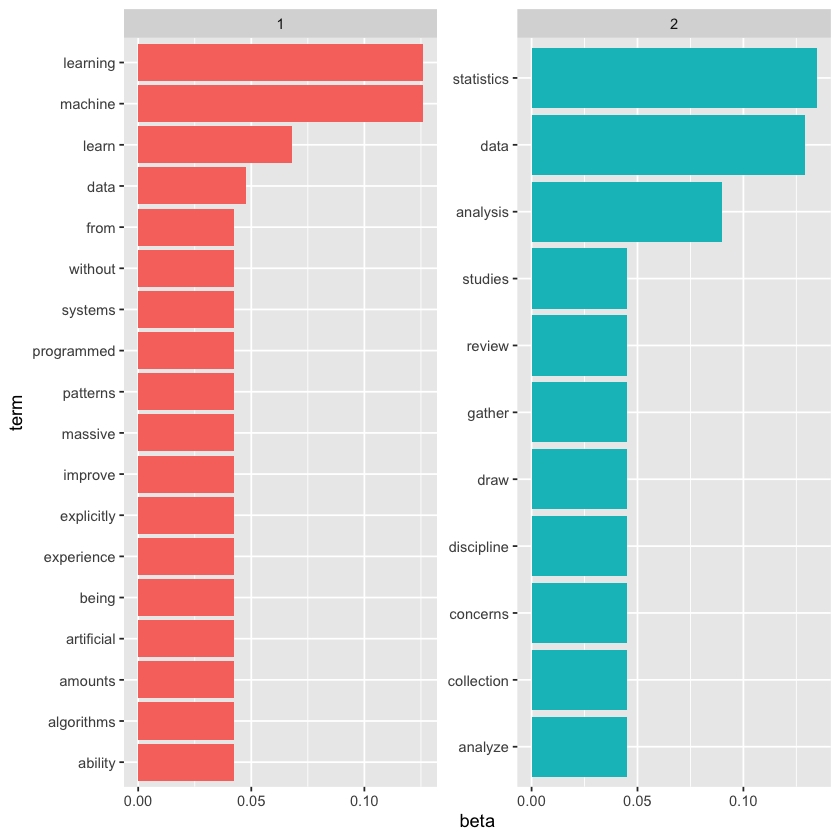

In [21]:
library(ggplot2)
library(dplyr)

#%>% pipe operater; nested functions
ap_top_terms <- ap_topics %>%
  group_by(topic) %>%
  top_n(10, beta) %>%
  ungroup() %>%
  arrange(topic, -beta)

ap_top_terms %>%
  mutate(term = reorder_within(term, beta, topic)) %>%
  ggplot(aes(term, beta, fill = factor(topic))) +
  geom_col(show.legend = FALSE) +
  facet_wrap(~ topic, scales = "free") +
  coord_flip() +
  scale_x_reordered()

Besides estimating each topic as a mixture of words, LDA also models each document as a mixture of topics. We can examine the per-document-per-topic probabilities, called  (“gamma”), with the matrix = "gamma" argument to tidy().

In [22]:
ap_documents <- tidy(ap_lda, matrix = "gamma")
ap_documents

document,topic,gamma
<chr>,<int>,<dbl>
T2.txt,1,0.010546399
T3.txt,1,0.017332824
T4.txt,1,0.305185853
T5.txt,1,0.986881810
T6.txt,1,0.991848155
T2.txt,2,0.989453601
T3.txt,2,0.982667176
T4.txt,2,0.694814147
T5.txt,2,0.013118190


Each of these values is an estimated proportion of words from that document that are generated from that topic. For example, the model estimates that  about 99% of the words in document 1 were generated from topic 2.

## Example 2

In [23]:
library(topicmodels)
library(tm)


HPCorpus <- Corpus(DirSource("HPCorpus"))
(summary(HPCorpus))

MyStopwords<-c("form","have","that","the","or","of","a","they","with","there","said","their","then","they","were","will","this","came","come","your","what","them","from","would","could","more","like","some","when","page","back","into","about","over","still","long","been")

HP_dtm <- DocumentTermMatrix(HPCorpus,
                               control = list(
                                 #stopwords = TRUE, ## remove normal stopwords
                                 wordLengths=c(4, 10), 
                                 ## get rid of words of len 4 or smaller or larger than 10
                                 removePunctuation = TRUE,
                                 removeNumbers = TRUE,
                                 tolower=TRUE,
                                 #stemming = TRUE,
                                 remove_separators = TRUE,
                                 #stopwords = MyStopwords,
                                 removeWords
                                 #bounds = list(global = c(minTermFreq, maxTermFreq))
                               ))

DTM_mat <- as.matrix(HP_dtm)
x<- DTM_mat[-1,]

# set a seed so that the output of the model is predictable
ap_lda <- LDA(x, k = 2, control = list(seed = 1234))
ap_lda


library(tidytext)

ap_topics <- tidy(ap_lda, matrix = "beta")
ap_topics

           Length Class             Mode
01lort.txt 2      PlainTextDocument list
02lort.txt 2      PlainTextDocument list
03lort.txt 2      PlainTextDocument list
1.txt      2      PlainTextDocument list
2.txt      2      PlainTextDocument list
3.txt      2      PlainTextDocument list
4.txt      2      PlainTextDocument list
5.txt      2      PlainTextDocument list
6.txt      2      PlainTextDocument list
7.txt      2      PlainTextDocument list

Warning message in TermDocumentMatrix.SimpleCorpus(x, control):
"custom functions are ignored"


A LDA_VEM topic model with 2 topics.

topic,term,beta
<int>,<chr>,<dbl>
1,abandon,1.450476e-05
2,abandon,2.539553e-05
1,abandoned,4.726201e-05
2,abandoned,6.367054e-06
1,abandons,3.720076e-44
2,abandons,3.720076e-44
1,abashed,1.026693e-05
2,abashed,1.246906e-05
1,abide,4.091106e-06


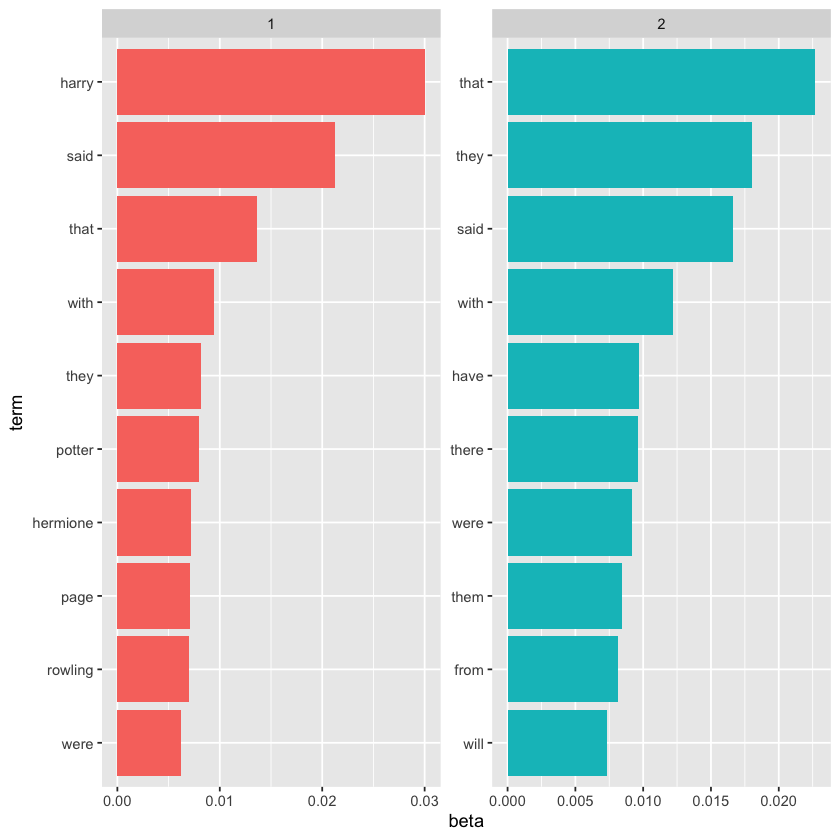

In [24]:
library(ggplot2)
library(dplyr)

ap_top_terms <- ap_topics %>%
  group_by(topic) %>%
  slice_max(beta, n = 10) %>% 
  ungroup() %>%
  arrange(topic, -beta)

ap_top_terms %>%
  mutate(term = reorder_within(term, beta, topic)) %>%
  ggplot(aes(beta, term, fill = factor(topic))) +
  geom_col(show.legend = FALSE) +
  facet_wrap(~ topic, scales = "free") +
  scale_y_reordered()

In [25]:
library(tidyr)

beta_wide <- ap_topics %>%
  mutate(topic = paste0("topic", topic)) %>%
  pivot_wider(names_from = topic, values_from = beta) %>% 
  filter(topic1 > .001 | topic2 > .001) %>%
  mutate(log_ratio = log2(topic2 / topic1))

beta_wide

########

ap_documents <- tidy(ap_lda, matrix = "gamma")
ap_documents

#tidy(HP_dtm) %>%
  #filter(document == 6) %>%
  #arrange(desc(count))

term,topic1,topic2,log_ratio
<chr>,<dbl>,<dbl>,<dbl>
about,3.534644e-03,3.236581e-03,-0.127094364
above,3.156241e-04,1.493104e-03,2.242036048
after,1.679368e-03,1.687636e-03,0.007084621
again,2.606661e-03,4.019318e-03,0.624747810
against,9.571081e-04,1.053418e-03,0.138324840
already,6.612056e-04,1.029352e-03,0.638566177
another,1.016023e-03,1.036317e-03,0.028532408
aragorn,1.971620e-57,3.069216e-03,180.022606000
around,3.297153e-03,2.534213e-05,-7.023539602


document,topic,gamma
<chr>,<int>,<dbl>
02lort.txt,1,1.628586e-06
03lort.txt,1,1.850015e-06
1.txt,1,9.908560e-01
2.txt,1,9.957002e-01
3.txt,1,9.959109e-01
4.txt,1,9.947968e-01
5.txt,1,9.950728e-01
6.txt,1,9.947730e-01
7.txt,1,9.779926e-01
